In [1]:
import pandas as pd
from dae_finder import PolyFeatureMatrix
import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns
import Multicollinearity as multi
from multiprocessing import Pool, cpu_count
import functools

In [2]:
# Load time series data
data = pd.read_excel('Beer_exp.xlsx')
data.rename(columns={
    'x_Exp_1': 'x1',
    'x_Exp_2': 'x2',
    'x_Exp_3': 'x3',
    'x_Exp_4': 'x4'
},inplace=True)
data_states = data.copy().drop(columns={'t_Exp'})

In [5]:
# Create function libarary and generate corresponding values for each degree
degree_range = [2,3,4,5]
candidate_libs = {}
for poly_degree in degree_range:
    poly_feature_ob = PolyFeatureMatrix(poly_degree)

    candidate_lib_full = poly_feature_ob.fit_transform(data_states)


    # Dropping 1 from the candidate library since we use fit_with_intercept flag instead of using constants directly
    # in the candidate library
    candidate_lib_full = candidate_lib_full.drop(["1"], axis=1)
    candidate_libs[poly_degree] = candidate_lib_full

In [10]:
# Create function library and generate corresponding values
poly_degree = 5

poly_feature_ob = PolyFeatureMatrix(poly_degree)

candidate_lib_full = poly_feature_ob.fit_transform(data_states)


# Dropping 1 from the candidate library since we use fit_with_intercept flag instead of using constants directly
# in the candidate library
candidate_lib_full = candidate_lib_full.drop(["1"], axis=1)
candidate_lib_full

,x1,x2,x3,x4,x1^2,x1 x2,x1 x3,x1 x4,x2^2,x2 x3,...,x2 x3^3 x4,x2 x3^2 x4^2,x2 x3 x4^3,x2 x4^4,x3^5,x3^4 x4,x3^3 x4^2,x3^2 x4^3,x3 x4^4,x4^5
0,0.014701,10.000000,0.000000,0.000000e+00,0.000216,0.147012,0.000000,0.000000e+00,100.000000,0.000000,...,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00
1,0.014701,9.995934,0.004066,1.865008e-09,0.000216,0.146952,0.000060,2.741790e-11,99.918691,0.040646,...,1.253413e-15,5.748813e-22,2.636709e-28,1.209334e-34,1.111689e-12,5.098794e-19,2.338576e-25,1.072595e-31,4.919485e-38,2.256336e-44
2,0.014701,9.991869,0.008131,1.472746e-08,0.000216,0.146893,0.000120,2.165116e-10,99.837448,0.081243,...,7.910205e-14,1.432774e-19,2.595181e-25,4.700648e-31,3.553766e-11,6.436930e-17,1.165920e-22,2.111829e-28,3.825152e-34,6.928492e-40
3,0.014701,9.987806,0.012194,4.906997e-08,0.000216,0.146833,0.000179,7.213886e-10,99.756271,0.121789,...,8.885975e-13,3.575866e-18,1.438988e-23,5.790731e-29,2.695868e-10,1.084862e-15,4.365669e-21,1.756819e-26,7.069733e-32,2.844980e-37
4,0.014701,9.983745,0.016255,1.148330e-07,0.000216,0.146773,0.000239,1.688186e-09,99.675160,0.162286,...,4.924096e-12,3.478601e-17,2.457438e-22,1.736044e-27,1.134864e-09,8.017183e-15,5.663695e-20,4.001086e-25,2.826546e-30,1.996798e-35
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
710,0.624678,0.013576,4.944838,1.742630e-01,0.390223,0.008481,3.088934,1.088584e-01,0.000184,0.067133,...,2.860514e-01,1.008085e-02,3.552635e-04,1.251998e-05,2.956381e+03,1.041870e+02,3.671697e+00,1.293958e-01,4.560089e-03,1.607039e-04
711,0.624679,0.013344,4.936703,1.736766e-01,0.390223,0.008336,3.083853,1.084921e-01,0.000178,0.065874,...,2.788237e-01,9.809208e-03,3.450947e-04,1.214067e-05,2.932143e+03,1.031548e+02,3.629057e+00,1.276727e-01,4.491614e-03,1.580181e-04
712,0.624679,0.013115,4.928592,1.730928e-01,0.390223,0.008193,3.078786,1.081274e-01,0.000172,0.064639,...,2.717813e-01,9.544994e-03,3.352215e-04,1.177302e-05,2.908134e+03,1.021341e+02,3.586962e+00,1.259746e-01,4.424244e-03,1.553800e-04
713,0.624679,0.012890,4.920505,1.725116e-01,0.390223,0.008052,3.073734,1.077643e-01,0.000166,0.063427,...,2.649194e-01,9.288005e-03,3.256351e-04,1.141668e-05,2.884352e+03,1.011246e+02,3.545404e+00,1.243009e-01,4.357958e-03,1.527889e-04


In [23]:
with Pool(processes=min(len(degree_range),cpu_count())) as pool:
    process_func = functools.partial(multi.process_single_degree,candidate_libs=candidate_libs,comb=3)
    results = pool.map(process_func,degree_range)

combination_results = {}
filtered_results = {}
dropped_results = {}
regression_results = {}
all_data =[]

for degree, result in zip(degree_range,results):
    combination_results[degree] = result['combination']
    filtered_results[degree] = result['filtered']
    dropped_results[degree] = result['dropped']
    regression_results[degree] = result['regression']

    for combo_id, result in result['regression'].items():
        all_data.append({
            'polynomial_degree': degree,
            'combination_id': combo_id,
            'combination': ', '.join(result['combination_terms']),
            'equation': result['equation'],
            'r2_test': result['r2_test'],
            'mse_test': result['mse_test'],
            'condition_number': result['condition_number'],
            'n_terms': len(result['combination_terms'])
        })

All = pd.DataFrame(all_data)

/opt/anaconda3/lib/python3.12/site-packages/joblib/parallel.py:1359: UserWarning: Loky-backed parallel loops cannot be called in a multiprocessing, setting n_jobs=1
  n_jobs = self._backend.configure(n_jobs=self.n_jobs, parallel=self,
/opt/anaconda3/lib/python3.12/site-packages/joblib/parallel.py:1359: UserWarning: Loky-backed parallel loops cannot be called in a multiprocessing, setting n_jobs=1
  n_jobs = self._backend.configure(n_jobs=self.n_jobs, parallel=self,
/opt/anaconda3/lib/python3.12/site-packages/joblib/parallel.py:1359: UserWarning: Loky-backed parallel loops cannot be called in a multiprocessing, setting n_jobs=1
  n_jobs = self._backend.configure(n_jobs=self.n_jobs, parallel=self,
/opt/anaconda3/lib/python3.12/site-packages/joblib/parallel.py:1359: UserWarning: Loky-backed parallel loops cannot be called in a multiprocessing, setting n_jobs=1
  n_jobs = self._backend.configure(n_jobs=self.n_jobs, parallel=self,


In [32]:
for deg, combos in filtered_results.items():          # First：degree
    for combo_id, result in combos.items():           # Second：combo_id
        print(f"[deg={deg}] "
              f"{', '.join(result['terms'])}: "
              f"min_sv = {result['min_singular_value']:.2e}, "
              f"cond = {result['condition_number']:.2e}")


[deg=2] x1, x2, x3: min_sv = 1.43e+00, cond = 1.24e+02
[deg=2] x1, x2, x4: min_sv = 1.11e+00, cond = 1.56e+02
[deg=2] x1, x2, x1^2: min_sv = 5.73e-01, cond = 3.02e+02
[deg=2] x1, x2, x1 x3: min_sv = 1.65e+00, cond = 1.05e+02
[deg=2] x1, x2, x1 x4: min_sv = 7.91e-01, cond = 2.19e+02
[deg=2] x1, x2, x2^2: min_sv = 9.17e+00, cond = 1.73e+02
[deg=2] x1, x2, x2 x3: min_sv = 9.84e+00, cond = 2.94e+01
[deg=2] x1, x2, x2 x4: min_sv = 4.27e+00, cond = 4.05e+01
[deg=2] x1, x2, x3^2: min_sv = 2.76e+00, cond = 2.79e+02
[deg=2] x1, x2, x3 x4: min_sv = 3.68e+00, cond = 4.70e+01
[deg=2] x1, x2, x4^2: min_sv = 5.98e-01, cond = 2.89e+02
[deg=2] x1, x3, x4: min_sv = 1.08e+00, cond = 1.14e+02
[deg=2] x1, x3, x1^2: min_sv = 5.93e-01, cond = 2.07e+02
[deg=2] x1, x3, x1 x2: min_sv = 1.45e+00, cond = 8.50e+01
[deg=2] x1, x3, x1 x3: min_sv = 1.44e+00, cond = 9.88e+01
[deg=2] x1, x3, x1 x4: min_sv = 7.89e-01, cond = 1.55e+02
[deg=2] x1, x3, x2^2: min_sv = 1.46e+00, cond = 1.08e+03
[deg=2] x1, x3, x2 x3: min_sv

In [35]:
for combo_id, results in sorted(regression_results[2].items(),
                                key = lambda x: x[1]['r2_test'],
                                reverse=True):
     print(f"Combination {','.join(results['combination_terms'])}-----"
           f" Linear Euqation: {results['equation']},"
           f" R^2 = {results['r2_test']:.2e}, MSE = {results['mse_test']:.2e}"
          )

Combination x1^2,x1 x3,x3^2----- Linear Euqation: x1 x3 = 4.9263*x1^2 +0.0499*x3^2, R^2 = 1.00e+00, MSE = 3.40e-04
Combination x4,x1 x2,x1 x4----- Linear Euqation: x1 x4 = 0.6279*x4 -0.0074*x1 x2, R^2 = 1.00e+00, MSE = 8.15e-07
Combination x2,x2^2,x2 x3----- Linear Euqation: x2 = 0.0995*x2^2 +0.1087*x2 x3, R^2 = 1.00e+00, MSE = 2.56e-03
Combination x4,x2 x4,x3^2----- Linear Euqation: x3^2 = 138.1558*x4 +17.9108*x2 x4, R^2 = 1.00e+00, MSE = 8.80e-02
Combination x4,x1 x4,x2 x3----- Linear Euqation: x1 x4 = 0.6267*x4 -0.0006*x2 x3, R^2 = 1.00e+00, MSE = 2.59e-06
Combination x4,x1 x4,x3^2----- Linear Euqation: x4 = 1.1650*x1 x4 +0.0019*x3^2, R^2 = 1.00e+00, MSE = 8.95e-06
Combination x3,x4,x1 x4----- Linear Euqation: x4 = 0.0072*x3 +1.3504*x1 x4, R^2 = 9.99e-01, MSE = 1.15e-05
Combination x1 x4,x2 x4,x3^2----- Linear Euqation: x3^2 = 217.4340*x1 x4 +23.8715*x2 x4, R^2 = 9.99e-01, MSE = 2.57e-01
Combination x3^2,x3 x4,x4^2----- Linear Euqation: x3 x4 = 0.0177*x3^2 +13.4558*x4^2, R^2 = 9.99e

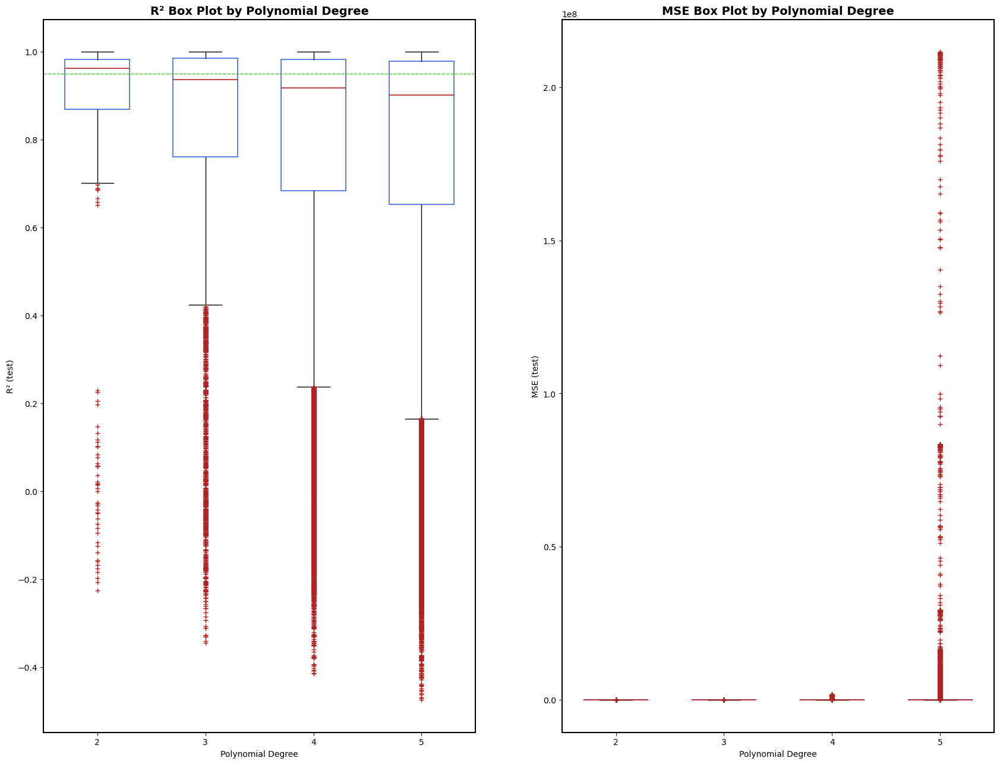

In [33]:
fig, (ax1,ax2) = plt.subplots(1,2,figsize=(20,16))
fig.subplots_adjust(wspace=0.35)

box_style = dict(
    patch_artist=True,           
    widths=0.6,                  
    boxprops=dict(facecolor='white',
                       edgecolor='royalblue',
                       linewidth=1.2),
    whiskerprops=dict(color='black',  linewidth=1.0),
    capprops=dict(color='black',  linewidth=1.0),
    medianprops=dict(color='firebrick', linewidth=1.2),
    flierprops=dict(marker='+', markersize=6,markeredgewidth=1.0,
                       markeredgecolor='firebrick',markerfacecolor='none')
)

# Create boxplots
for ax, column, title, ylabel in [
    (ax1, 'r2_test', 'R² Box Plot by Polynomial Degree', 'R² (test)'),
    (ax2, 'mse_test', 'MSE Box Plot by Polynomial Degree', 'MSE (test)')
]:
    All.boxplot(column=column, by='polynomial_degree', ax=ax, **box_style)
    ax.set_title(title, fontsize=14, fontweight='bold')
    ax.set_xlabel('Polynomial Degree')
    ax.set_ylabel(ylabel)
    ax.grid(False)
    
    # Style spines
    for spine in ax.spines.values():
        spine.set_visible(True)
        spine.set_color('black')
        spine.set_linewidth(1.5)

# Add reference line to R² plot
ax1.axhline(0.95, color='limegreen', ls='--', lw=1)
# Remove pandas’ automatic suptitle
fig.suptitle('')                        

plt.xticks(rotation=0)
plt.show()